# Анализ рынка заведений общественного питания Москвы

**Цель:** подготовка исследование рынка общественного питания Москвы, поиск особеннностей, которые в будущем помогут в выборе подходящего инвесторам места и типа заведения.



Презентация: https://disk.yandex.ru/i/4M5OH7kE4AQQtg

## Подготовка к исследованию

### Загрузка библиотек

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly import graph_objects as go
from scipy import stats
from numpy import median
import json
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster

### Загрузка данных

In [2]:
# загружаем датасет

try: data = pd.read_csv('/datasets/moscow_places.csv')
except: data = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

    # загружаем JSON-файл с границами округов Москвы
with open('/datasets/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)
state_geo = '/datasets/admin_level_geomap.geojson'

In [3]:
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
# замена значений в столбце chain на логические
def to_logical_values(x):
    if x==1:
        return True
    elif x==0:
        return False
data['chain'] = data['chain'].apply(to_logical_values)
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,False,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,False,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,False,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,False,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,True,148.0


In [6]:
print('Дубликатов строк в датасете: {}'.format(data.duplicated().sum()))
print('Всего заведений в датасете: {}'.format(len(data)))

Дубликатов строк в датасете: 0
Всего заведений в датасете: 8406


In [7]:
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [8]:
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [9]:
dup1=data[['category', 'address','district','hours','lat','lng']]
data[dup1.duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1452,Сикварули,ресторан,"Москва, улица Куусинена, 11, корп. 2",Северный административный округ,"ежедневно, 10:00–22:00",55.782729,37.513952,4.4,NaN,NaN,NaN,NaN,True,10.0
3759,Patriki,ресторан,"Москва, Малая Бронная улица, 21/13с2",Центральный административный округ,"ежедневно, 09:00–23:00",55.762784,37.594602,4.5,NaN,NaN,NaN,NaN,False,NaN
4286,Пловная-чебуречная,быстрое питание,"Москва, площадь Киевского Вокзала, 1",Западный административный округ,"ежедневно, круглосуточно",55.743041,37.566494,3.3,NaN,Средний счёт:250–350 ₽,300.0,NaN,False,10.0
5316,Леон,ресторан,"Москва, улица Металлургов, 29А",Восточный административный округ,пн-сб 11:00–23:00; вс 12:00–23:00,55.759603,37.791702,4.4,NaN,NaN,NaN,NaN,False,NaN
7407,Старый дворик,кафе,"Москва, улица Нижние Поля, 19Б, стр. 1",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.658424,37.737291,4.1,средние,Средний счёт:от 300 ₽,300.0,NaN,True,45.0


Всего в датасете имеется информация о 8406 заведениях. Явны дубликаты не выявлены.

Выявлены 5 неявных дубликатов (совпадение по нескольким столбцам), но ситуация когда несколько заведений находятся в одном торговом или бизнес центре вполне возможна. Так как неявных дубликатов не много и существенное влияние на исследование они не оказывают, ими можно принебречь и оставить для анализа.

Произведена замена типа данных в столбце chain на логический. В остальных столбцах типы данных выгружены корректно.

## Предобработка данных

### Создание столбцы street с названиями улиц из столбца с адресом

In [10]:
words = ['улица','ул','переулок','шоссе','проспект','площадь','проезд',
         'село','аллея','бульвар','набережная','тупик','линия']

str_pat = r".*,\s*\b([^,]*?(?:{})\b[^,]*)[,$]+".format("|".join(words))

data["street"] = data["address"].str.extract(str_pat)
data["street"].unique()

array(['улица Дыбенко', 'Клязьминская улица', 'улица Маршала Федоренко',
       ..., 'улица Хлобыстова', 'Новороссийская улица',
       'Чонгарский бульвар'], dtype=object)

### Создание столбцы is_24/7 с логическим значением true для круглосуточных заведений

In [11]:
def to_logical_values_hours(x):
    if x=='ежедневно, круглосуточно':
        return True
    else: return False
data['is_24/7'] = data['hours'].apply(to_logical_values_hours)
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,False,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,False,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,False,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,False,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,True,148.0,Правобережная улица,False


Созданы столбцы с названием улиц и параметром работы заведения в круглосуточном режиме без выходных. 

Пропуски имеются в столбцах: hours, price , avg_bill, middle_avg_bill, middle_coffee_cup, seats. Заполнять данные столбцы средними иди медианными значениями будет не корректно, так как они могут значительно отличаться от заведения к заведению в зависимости от уровня и местоположения заведения. 

## Анализ данных

### Исследование количества объектов общественного питания по категориям

In [12]:
# создание сводной таблицы по категориям заведений и процента от общего количества
object_types = (data
                .groupby('category', as_index=False)
                .agg({'name':'count'})
                .sort_values(by='name', ascending=False))

object_types['percent'] = (object_types['name']/object_types['name']
                           .sum()*100).round(1).astype('str')
object_types

,category,name,percent
3,кафе,2378,28.3
6,ресторан,2043,24.3
4,кофейня,1413,16.8
0,"бар,паб",765,9.1
5,пиццерия,633,7.5
2,быстрое питание,603,7.2
7,столовая,315,3.7
1,булочная,256,3.0


In [13]:
# построение графика распределения категорий заведений
fig = px.bar(object_types, y='name', x='category', text='name', color='category', width=900, height=550)
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Соотношение видов объектов общественного питания по количеству',
    xaxis_title="Тип объекта",
    yaxis_title="Количество")
fig.update_traces(textposition='outside')
 
fig.show()

In [14]:
# построение графика распределения категорий заведений
fig = go.Figure(go.Pie(
labels = object_types['category'],
values = data['category'].value_counts().to_list(),
    title='Соотношение видов объектов общественного питания по всем улицам Москвы'))
fig.update_traces(textposition='inside', textinfo='percent+value+label')
fig.show()

Самые распространенные категории заведений общественного питания это кафе (28,3%), рестораны (24,3%) и кофейни(16,8%). Остальные категории заведений имеют менее 10% заведений.

### Исследование количества посадочных мест в местах по категориям

In [15]:
# создание сводной таблицы распределения посалочных мест по категориям
number_of_seats_by_object = (data
                             .pivot_table(index='category', values='seats', aggfunc='median')
                             .sort_values(by='seats', ascending=False)
                             .reset_index())
number_of_seats_by_object.columns=['Тип объекта', 'Кол-во посадочных мест']


# построение графика распределения количества посадочных мест по категориям
fig = px.bar(number_of_seats_by_object, x='Тип объекта', y='Кол-во посадочных мест', 
             text = 'Кол-во посадочных мест', color='Тип объекта', width = 900, height = 550)
fig.update_layout(title={'text':'Среднее кол-во посадочных мест по видам объектов','x':0.125})
fig.show()

Наибольшее количество посадочных мест в заведениях предполагающих длительное прибывание посетителей, а именно рестораны (86), бар/паб (82,5), кофейни(80).

### Определение соотношения сетевых и несетевых заведений.

In [16]:
fig = go.Figure(data=go
                .Pie(labels=data['chain']
                     .value_counts()
                     .reset_index()['index'], values=data['chain'].value_counts()))
fig.update_layout(
    title={
        'text':'Соотношение сетевых и несетевых заведений по количеству',
        'y':0.9,
        'x':0.48})
for trace in fig.data:
    trace['labels']=['Несетевые', 'Сетевые']
fig.show()

В целом сетевые заведения занимают немногим более трети рынка (38%)

### Определение какие категории заведений чаще являются сетевыми

In [17]:
# создание тадлицы распрделения сетевых заведений по категориям
chain_object_types = (data[data['chain']==True]
                      .groupby('category', as_index=False)
                      .agg({'name':'count'})
                      .sort_values(by='name', ascending=False))
chain_object_types = chain_object_types.merge(object_types[['category', 'name']], 
                                              left_on='category', right_on='category')
chain_object_types.columns=['object_type', 'chain_objects', 'all_objects']

chain_object_types['percent'] = (chain_object_types['chain_objects'] / 
                                 chain_object_types['chain_objects']
                                 .sum()*100).round(1).astype('str')+'%'
chain_object_types['percent_of_type'] = (chain_object_types['chain_objects'] /
                                         chain_object_types['all_objects']*100).round(2)
chain_object_types['percent_of_type_text'] = chain_object_types['percent_of_type'].astype('str')+'%'

In [18]:
# построение графика распределения сетевых заведений по категориям
fig = px.bar(chain_object_types.sort_values(by='percent_of_type', ascending = False), 
             x='object_type', y='percent_of_type', width = 900, height = 550, color='object_type', 
             text='percent_of_type_text')
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Доля СЕТЕВЫХ объектов от всех объектов общественного питания (по типам)',
    xaxis_title="Тип объекта",
    yaxis_title="% заведений")
fig.update_traces(textposition='outside')
fig.show()

Чаще всего сетевыми являются булочные (61%), пиццерии(52%) и кофейни(50%), остальные категории заведений сетевыми являются в в менее чем трети случаях.

### Определение топ-15 популярных сетей в Москве.

In [19]:
# создание таблицы с топ-15 популярных сетей
top_15_chain_object_types = (data[data['chain']==True]
                             .pivot_table(index=['name','category'], values='address', aggfunc='count')
                             .sort_values(by='address', ascending=False)
                             .reset_index()
                             .head(15))
top_15_chain_object_types.columns = ['Название сети','Категория','Кол-во заведений']
top_15_chain_object_types

,Название сети,Категория,Кол-во заведений
0,Шоколадница,кофейня,119
1,Домино'с Пицца,пиццерия,76
2,Додо Пицца,пиццерия,74
3,One Price Coffee,кофейня,71
4,Яндекс Лавка,ресторан,69
5,Cofix,кофейня,65
6,Prime,ресторан,49
7,КОФЕПОРТ,кофейня,42
8,Кулинарная лавка братьев Караваевых,кафе,39
9,Теремок,ресторан,36


In [20]:
# Создание графика количества заведений из топ-15 популярных сетей БЕЗ РАЗБИВКИ по категориям
fig = px.bar(top_15_chain_object_types, 
             x='Название сети', y='Кол-во заведений', width = 900, height = 550,
             text='Кол-во заведений')
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Топ-15 сетей общественного питания в Москве',
    xaxis_title="Название сети",
    yaxis_title="Кол-во заведений")
fig.update_traces(textposition='outside')
fig.show()
# Создание графика количества заведений из топ-15 популярных сетей С РАЗБИВКОЙ по категориям
fig = px.bar(top_15_chain_object_types, 
             x='Название сети', y='Кол-во заведений', width = 900, height = 550, color='Категория', 
             text='Кол-во заведений')
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Топ-15 сетей общественного питания в Москве',
    xaxis_title="Название сети",
    yaxis_title="Кол-во заведений")
fig.update_traces(textposition='outside')
fig.show()

Самые популярные сети в городе Москве это сеть Кофеин Шоколадницы и рестораны Домино'с пицца и Додо пицца. Данные заведения присутствуют и в других регионах. Вероятно крупным федеральным сетям проще добится больщого количества заведений в городе, чем региональным сетям.

### Распределение заведений по административным округам Москвы

In [21]:
# таблица с разбивкой по категориям и по округам
district_object_types = (data
                         .pivot_table(index=['category','district'], values='address', aggfunc='count')
                         .sort_values(by='address', ascending=False)
                         .reset_index())
# таблица с разбивкой по округам
object_by_district = (data
                      .pivot_table(index='district', values='name', aggfunc='count')
                      .sort_values(by='name', ascending=False))

# подготовка данных для построения графика
y1 = district_object_types[district_object_types['category'] == 'бар,паб']['address'].to_list()
y2 = district_object_types[district_object_types['category'] == 'булочная']['address'].to_list()
y3 = district_object_types[district_object_types['category'] == 'быстрое питание']['address'].to_list()
y4 = district_object_types[district_object_types['category'] == 'кафе']['address'].to_list()
y5 = district_object_types[district_object_types['category'] == 'кофейня']['address'].to_list()
y6 = district_object_types[district_object_types['category'] == 'пиццерия']['address'].to_list()
y7 = district_object_types[district_object_types['category'] == 'ресторан']['address'].to_list()
y8 = district_object_types[district_object_types['category'] == 'столовая']['address'].to_list()
street = list(district_object_types['district'].unique())

# построение графика распределения типов заведений по округам
fig = go.Figure(data=[
    go.Bar(name='бар,паб', x=street, y=y1),
    go.Bar(name='булочная', x=street, y=y2),
    go.Bar(name='быстрое питание', x=street, y=y3),
    go.Bar(name='кафе', x=street, y=y4),
    go.Bar(name='кофейня', x=street, y=y5),
    go.Bar(name='пиццерия', x=street, y=y6),
    go.Bar(name='ресторан', x=street, y=y7),
    go.Bar(name='столовая', x=street, y=y8,text= object_by_district['name'], textposition='outside')
])
fig.update_layout(title_text='Распределение заведений по административным округам Москвы')
fig.update_layout(barmode='stack')
fig.show()

https://habr.com/ru/post/468295/
https://www.shanelynn.ie/bar-plots-in-python-using-pandas-dataframes/

Хотя во всех округах сохраняются лидирующие категории заведений (кафе и рестораны) аналогично картине во всем городе. Особенно выделяется Центральный административный округ. Это легко объясняется, что там находится туристическия, деловой и административный центр города и основные органы управления государства.

### Распределение средних рейтингов по категориям заведений

In [22]:
# таблица распределения среднего рейтинга на категории
avg_rating_object_types = (round(data
                                 .pivot_table(index=['category'], values='rating', aggfunc='mean')
                                 .sort_values(by='rating', ascending=False)
                                 .reset_index(),2))
avg_rating_object_types.columns = ['Категория','Средний рейтинг']
avg_rating_object_types

,Категория,Средний рейтинг
0,"бар,паб",4.39
1,пиццерия,4.30
2,ресторан,4.29
3,кофейня,4.28
4,булочная,4.27
5,столовая,4.21
6,кафе,4.12
7,быстрое питание,4.05


In [23]:
# график распределения среднего рейтинга на категории
fig = px.bar(avg_rating_object_types, 
             x='Категория', y='Средний рейтинг', width = 900, height = 550,
             text='Средний рейтинг')
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Распределение среднего рейтинга по категориям',
    xaxis_title="Категория",
    yaxis_title="Средний рейтинг")
fig.update_traces(textposition='outside')
fig.show()

Рейтинг заведений незначительно отличается между категориями, что косвенно может показывать на влияние рейтинга на посещаемость заведения. Как следстие владельцы стараются максимально поднять рейтинг. А заведения с низкими оценками вероятно быстро закрываются.

### Фоновая картограмма (хороплет) со средним рейтингом заведений каждого района.

In [24]:
# таблица распределения среднего рейтинга по округам
rating_df = data.groupby('district', as_index=False)['rating'].agg('median')
rating_df.columns = ['Округ','Средний рейтинг']
rating_df

,Округ,Средний рейтинг
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [25]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['Округ','Средний рейтинг'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)
m

Средний рейтинг незначительно выше в Центральном административном округе. Вероятно это связано с более высоким уровнем заведений в центре города. В остальных окргах разница незначительна.

### Отображение всех заведений датасета на карте

In [26]:
m1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m1)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m1

### Топ-15 улиц по количеству заведений.

Топ-15  по количеству заведений:
                       street  objects
1017           проспект Мира      184
744        Профсоюзная улица      122
1014    проспект Вернадского      108
503       Ленинский проспект      107
501   Ленинградский проспект       95
355        Дмитровское шоссе       88
436          Каширское шоссе       77
286         Варшавское шоссе       75
502      Ленинградское шоссе       69
522         Люблинская улица       60
1080          улица Вавилова       55
495     Кутузовский проспект       54
1237    улица Миклухо-Маклая       49
751          Пятницкая улица       48
162       Алтуфьевское шоссе       47


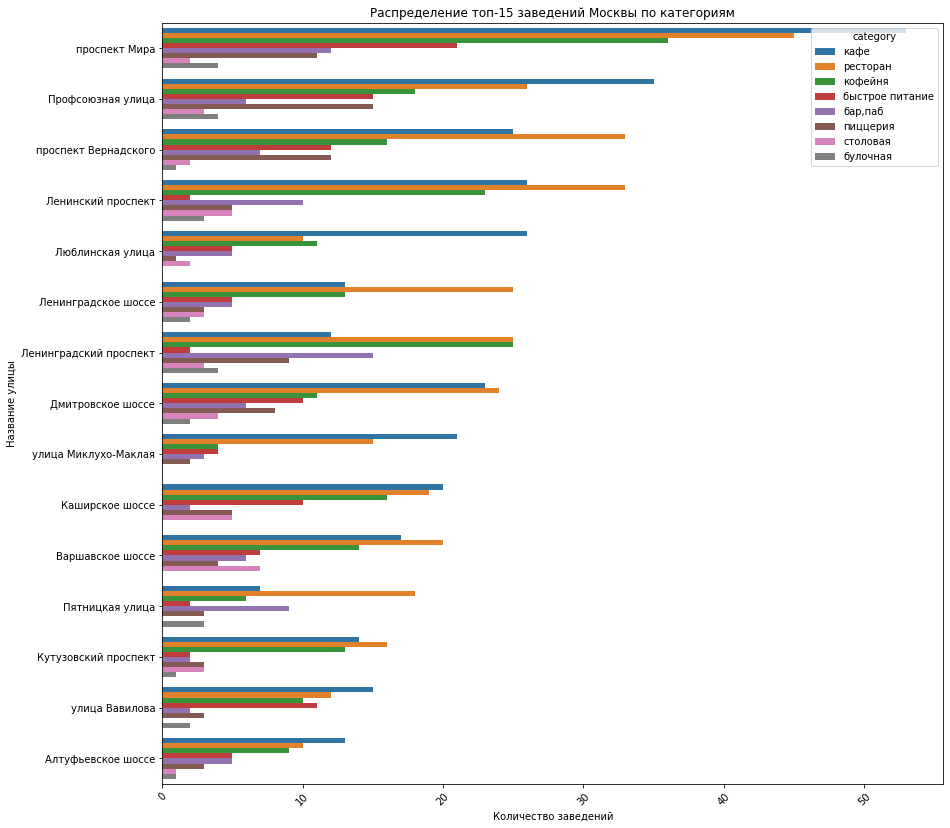

In [27]:
# создание таблице топ-15 улиц по количеству заведений
top_streets = (data
               .groupby('street', as_index=False).agg({'address':'count'})
               .sort_values(by='address', ascending = False))
top_streets.columns = ['street', 'objects']
top_15_streets = top_streets.head(15)
print('Топ-15  по количеству заведений:\n', top_15_streets)

# создание таблице топ-15 улиц по количеству с разбивкой по категориям
top_15_streets_by_category = (data
                       .query('street.isin(@top_15_streets.street)')
                       .groupby(['street', 'category'])['name']
                       .agg('count')
                       .sort_values(ascending=False)
                       .reset_index()
                  )

# построение графика топ-15 улиц по количеству с разбивкой по категориям
plt.figure(figsize=(14,14))
sns.barplot(y='street', x='name', hue='category', data=top_15_streets_by_category)
plt.xticks(rotation=45)
plt.ylabel('Название улицы')
plt.xlabel('Количество заведений')
plt.title('Распределение топ-15 заведений Москвы по категориям');

### Определение улиц только с одним объектом

In [28]:
top_streets

,street,objects
1017,проспект Мира,184
744,Профсоюзная улица,122
1014,проспект Вернадского,108
503,Ленинский проспект,107
501,Ленинградский проспект,95
...,...,...
946,Чонгарский бульвар,1
944,Черёмушкинский проезд,1
942,Чермянский проезд,1
939,Челюскинская улица,1


In [29]:
# создание таблицы с единственными заведениями
streets_with_1_object = top_streets.query('objects == 1')
print('Всего улиц с 1 объектом общественного питания:', len(streets_with_1_object))
# создание сводной таблицы с единственными заведениями на улице
streets_with_1_object ['category'] = data.loc[streets_with_1_object.index]['category']
streets_with_1_object_category = (streets_with_1_object.pivot_table(index=['category'], values='street', aggfunc='count').reset_index())
streets_with_1_object_category = streets_with_1_object_category.sort_values(by='street', ascending = False)
streets_with_1_object_category

Всего улиц с 1 объектом общественного питания: 414


/tmp/ipykernel_48/3314829120.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,category,street
3,кафе,132
6,ресторан,77
4,кофейня,63
2,быстрое питание,39
5,пиццерия,39
0,"бар,паб",29
1,булочная,18
7,столовая,17


In [30]:
fig = px.bar(streets_with_1_object_category, 
             x='category', y='street', text = 'street', width = 900, height = 550)
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Категории заведений единственные на улице',
    xaxis_title="Категория",
    yaxis_title="Кол-во заведений")
fig.update_traces(textposition='outside')
fig.show()

Всего в Москве 414 улиц где есть единственное заведение общественного питания. Кафе (132 заведения) чаще являются единственными заведениями на улице.

### Определение влияния удалённости от центра на цены в заведениях

In [31]:
# создание таблицы среднего чека по округам
avg_bill = (data
            .groupby('district', as_index=False)['middle_avg_bill'].agg('median')
            .sort_values(by='middle_avg_bill', ascending = False))
avg_bill.columns = ['Округ','Средний чек']
avg_bill

,Округ,Средний чек
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [32]:
# создание визуализации величины среднего чека по округам
Choropleth(
    geo_data=state_geo,
    data=avg_bill,
    columns=['Округ','Средний чек'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)
m

Ожидаемо самый большой средний чек в Центральном административном округе, но при этом аналогичный показатели и Западного административного округа (1000р). На средний чек больше влияет не географическая удаленность района, а уровень жизни проживающих в этом районе.

### Выводы

* Всего в датасете имеется информация о 8406 заведениях. Явны дубликаты не выявлены.
* Выявлены 5 неявных дубликатов (совпадение по нескольким столбцам), но ситуация когда несколько заведений находятся в одном торговом или бизнес центре вполне возможна. Так как неявных дубликатов не много и существенное влияние на исследование они не оказывают, ими можно принебречь и оставить для анализа.
* Произведена замена типа данных в столбце chain на логический. В остальных столбцах типы данных выгружены корректно.
* Пропуски имеются в столбцах: hours, price , avg_bill, middle_avg_bill, middle_coffee_cup, seats. Заполнять данные столбцы средними иди медианными значениями будет не корректно, так как они могут значительно отличаться от заведения к заведению в зависимости от уровня и местоположения заведения.
* Самые распространенные категории заведений общественного питания это кафе (28,3%), рестораны (24,3%) и кофейни(16,8%). Остальные категории заведений имеют менее 10% заведений.
* Наибольшее количество посадочных мест в заведениях предполагающих длительное прибывание посетителей, а именно рестораны (86), бар/паб (82,5), кофейни(80).
* В целом сетевые заведения занимают немногим более трети рынка (38%) Чаще всего сетевыми являются булочные (61%), пиццерии(52%) и кофейни(50%), остальные категории заведений сетевыми являются менее чем в трети случаях
* Самые популярные сети в городе Москве это сеть Кофеин Шоколадницы и рестораны Домино'с пицца и Додо пицца. Данные заведения присутствуют и в других регионах. Вероятно крупным федеральным сетям проще добится больщого количества заведений в городе, чем региональным сетям.
* Во всех округах сохраняются лидирующие категории заведений (кафе и рестораны) аналогично картине во всем городе
* Рейтинг заведений незначительно отличается между категориями, что косвенно может показывать на влияние рейтинга на посещаемость заведения. Как следстие владельцы стараются максимально поднять рейтинг. А заведения с низкими оценками вероятно быстро закрываются.
* Средний рейтинг незначительно выше в Центральном административном округе. Вероятно это связано с более высоким уровнем заведений в центре города. В остальных окргах разница незначительна.


## Детализированное исследование: открытия кофейни

### Определение количества кофеен в датасете. В каких районах их больше всего, каковы особенности их расположения?

In [33]:
# таблицы с выборкой кофеин
cofe_house = data.query("category == 'кофейня'")
print('Всего в городе Москва', len(cofe_house), 'кофеин')
# таблицы с выборкой кофеин с разбивкой по округам
cofe_house_by_district = cofe_house.groupby('district', as_index=False).agg({'address':'count'})
cofe_house_by_district.columns = ['district', 'objects']
object_by_district = object_by_district.reset_index()
cofe_house_by_district['total'] = object_by_district['name']
cofe_house_by_district['percent'] = round(cofe_house_by_district['objects']/cofe_house_by_district['total']*100,2)
cofe_house_by_district = cofe_house_by_district.sort_values(by='percent', ascending = False)
cofe_house_by_district.columns = ['Округ', 'Кофейни','Всего объектов','Процент']
cofe_house_by_district

Всего в городе Москва 1413 кофеин


,Округ,Кофейни,Всего объектов,Процент
5,Центральный административный округ,428,798,53.63
8,Южный административный округ,131,409,32.03
2,Северный административный округ,193,892,21.64
3,Северо-Восточный административный округ,159,891,17.85
1,Западный административный округ,150,900,16.67
7,Юго-Западный административный округ,96,709,13.54
6,Юго-Восточный административный округ,89,714,12.46
4,Северо-Западный административный округ,62,851,7.29
0,Восточный административный округ,105,2242,4.68


In [34]:
m2 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m2)
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
cofe_house.apply(create_clusters, axis=1)
m1

Всего в датафрейме информация о 1413 кофейнях расположенных во всех округах города. Разница в количестве обусловлена разницей в общем количестве заведений общественного питания в округе. 

При нанесении маркеров кофеин на карту становится заметно, что большая часть заведений находится в зонах максимальной проходимости(метро, объкты культурно-массовых мероприятий).

### Есть ли круглосуточные кофейни?

In [35]:
cofe_house_24_7 = cofe_house[cofe_house['is_24/7'] == 1]
print('Всего в городе Москва', len(cofe_house_24_7), 'круглосуточных кофеин')
cofe_house

Всего в городе Москва 59 круглосуточных кофеин


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,False,NaN,улица Маршала Федоренко,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,True,NaN,NaN,False
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,True,46.0,Коровинское шоссе,False
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,True,NaN,улица Маршала Федоренко,False
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,True,NaN,улица Дыбенко,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8356,Назис Пури,кофейня,"Москва, Люблинская улица, 61",Юго-Восточный административный округ,"ежедневно, 09:00–22:00",55.684103,37.738588,4.5,NaN,NaN,NaN,NaN,False,NaN,Люблинская улица,False
8365,Квадрат кофе,кофейня,"Москва, Волгоградский проспект, 73, стр. 1",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.709710,37.744450,4.2,NaN,Цена чашки капучино:100–220 ₽,NaN,160.0,False,206.0,Волгоградский проспект,False
8376,Шоколад имбирь корица,кофейня,"Москва, Грайвороновская улица, 23",Юго-Восточный административный округ,пн-пт 09:30–19:30,55.721213,37.740755,4.1,NaN,NaN,NaN,NaN,False,NaN,Грайвороновская улица,False
8385,Cafio,кофейня,"Москва, Новохохловская улица, 49",Юго-Восточный административный округ,"пн-пт 07:00–22:00; сб,вс 07:00–21:00",55.724357,37.716415,4.7,NaN,Цена чашки капучино:80–120 ₽,NaN,100.0,False,NaN,Новохохловская улица,False


In [36]:
fig = go.Figure(data=go
                .Pie(labels=cofe_house['is_24/7']
                     .value_counts()
                     .reset_index()['index'], values=cofe_house['is_24/7'].value_counts()))
fig.update_layout(
    title={
        'text':'Соотношение круглосуточных и некруглосуточных кофеин',
        'y':0.9,
        'x':0.48})
for trace in fig.data:
    trace['labels']=['Некруглосуточные', 'Круглосуточные']
fig.show()

Для города такого размера как Москва количество круглосуточных кофеин крайне мало, вероятно такой формат не рентабелен и может существовать только в транспортных узлах (железнодородные вокзалы, аэропорты).

### Какие у кофеен рейтинги? Как они распределяются по районам?

In [37]:
# таблицы распределения рейтина кофеин по округам
avg_rating_cofe_house = (round(cofe_house
                               .pivot_table(index=['district'], values='rating', aggfunc='mean')
                               .sort_values(by='rating', ascending=False)
                               .reset_index(),2))
avg_rating_cofe_house.columns = ['Округ','Средний рейтинг']
avg_rating_cofe_house

,Округ,Средний рейтинг
0,Центральный административный округ,4.34
1,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
3,Юго-Западный административный округ,4.28
4,Восточный административный округ,4.28
5,Южный административный округ,4.23
6,Юго-Восточный административный округ,4.23
7,Северо-Восточный административный округ,4.22
8,Западный административный округ,4.20


In [38]:
fig = px.bar(avg_rating_cofe_house, 
             x='Округ', y='Средний рейтинг', width = 900, height = 550,
             text='Средний рейтинг')
fig.update_xaxes(tickangle=30)
fig.update_layout(
    title='Распределение среднего рейтинга по категориям',
    xaxis_title="Категория",
    yaxis_title="Средний рейтинг")
fig.update_traces(textposition='outside')
fig.show()

Средний рейтинг кофеин не зависит от района и находится в диапозоне 4.2-4.3.

### На какую стоимость чашки капучино стоит ориентироваться при открытии.

In [39]:
# очистка данных от пустых и аномальных значений 
cofe_price = cofe_house['middle_coffee_cup'].dropna()
cofe_price = cofe_price[cofe_price>cofe_price.quantile ( .05)]
cofe_price = cofe_price[cofe_price<cofe_price.quantile ( .95)]
cofe_price = cofe_price.sort_values(ascending=False)
round(cofe_price.describe())

count    456.0
mean     172.0
std       55.0
min       75.0
25%      130.0
50%      170.0
75%      220.0
max      270.0
Name: middle_coffee_cup, dtype: float64

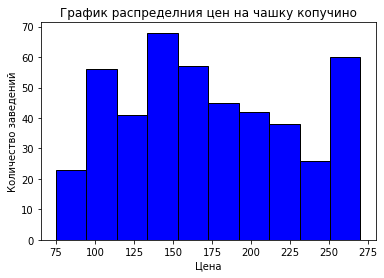

In [40]:
plt.hist(cofe_price, color = 'blue', edgecolor = 'black')
plt.title('График распределния цен на чашку копучино')
plt.xlabel('Цена')
plt.ylabel('Количество заведений')
plt.show()

Средняя стоимость чашки копучино по городу 172р. Минимальная 75, а максимальная 270. Чтобы не отпугнуть покупателя подозрительно маленькой или неоправданно большой ценой, оринтироваться стоит на цену чашку кофе между 2 и 3 квартилем, а именно 200р.

## Общий вывод

Рынок общественного питания в городе Москве крайне Насыщен. Исходя из примерно равного распределения рейтингов заведений, процентноо соотношения по категориям среди округов можно сделать вывод, что рынок достиг равновесия и не наблюдается явных свободных ниш. 

Аналогичная ситуация в категории кофейни, самые прибыльные места заняты. Остается рассматривать новые спальные районы в особенности недалеко или по дороге от метро.

Для города такого размера как Москва количество круглосуточных кофеин крайне мало, вероятно такой формат не рентабелен и может существовать только в транспортных узлах (железнодородные вокзалы, аэропорты).

Средняя стоимость чашки копучино по городу 172р. Минимальная 75, а максимальная 270. Чтобы не отпугнуть покупателя подозрительно маленькой или неоправданно большой ценой, оринтироваться стоит на цену чашку кофе между 2 и 3 квартилем, а именно 200р.

Но с другой стороны отсутствуют данные по популярным сетям быстрого питания транснацианального маштаба. Вероятно после их ухода в 2022 году слудует рассмотреть открытие заведения быстрого питания.

